Student name: Jianwei Su

Date: 06/11/2022

9.7

# Do the same as exercise 6, but using Plotly Express.

In [1]:
import numpy as np
import pandas as pd

# 9.3
# a. Plot the volume-weighted average daily returns using a line chart.

In [2]:
SP500=pd.read_csv('SP500.csv')
SP500.reset_index()

del SP500['Unnamed: 0']
del SP500['Adj Close']

SP500.head(10)

,Date,Ticker,Close,Dividends,High,Low,Open,Stock Splits,Volume,Daily return,1-week (5-day) moving average daily return,Rolling cumulative sum of volume
0,2020-06-10,A,88.694260,0.0,89.454698,88.348609,89.197926,0.0,1410300.0,NaN,NaN,1410300.0
1,2020-06-10,AAL,17.020000,0.0,18.160000,15.920000,17.690001,0.0,163952500.0,-0.808105,NaN,165362800.0
2,2020-06-10,AAP,136.555191,0.0,140.387844,136.545454,140.387844,0.0,864900.0,7.023219,NaN,166227700.0
3,2020-06-10,AAPL,87.121864,0.0,87.598411,85.455181,85.902098,0.0,166651600.0,-0.362003,NaN,332879300.0
4,2020-06-10,ABBV,88.445374,0.0,90.681606,88.354100,88.527518,0.0,11138300.0,0.015191,NaN,344017600.0
5,2020-06-10,ABC,94.110657,0.0,97.634351,94.091246,97.440204,0.0,905000.0,0.064054,1.186471,344922600.0
6,2020-06-10,ABMD,250.850006,0.0,252.979996,244.589996,246.410004,0.0,409000.0,1.665479,1.681188,345331600.0
7,2020-06-10,ABT,89.432686,0.0,90.005222,87.957664,88.161448,0.0,5829100.0,-0.643481,0.147848,351160700.0
8,2020-06-10,ACN,204.174911,0.0,205.539791,200.733489,202.059364,0.0,2077200.0,1.283001,0.476849,353237900.0
9,2020-06-10,ADBE,406.820007,0.0,409.980011,399.489990,399.589996,0.0,3611600.0,0.992507,0.672312,356849500.0


In [3]:
SP500 = SP500.dropna()
data = pd.DataFrame(dtype=float)


data['Volume-weighted average daily returns'] = SP500.groupby(SP500['Date']).apply(lambda x: np.average(x['Daily return'], weights=x['Volume']))
data = data.reset_index()

data["Date"] = pd.to_datetime(data["Date"])

data = data.set_index('Date')

data

,Volume-weighted average daily returns
Date,
2020-06-10,0.260742
2020-06-11,0.212743
2020-06-12,0.233559
2020-06-15,0.213383
2020-06-16,0.161214
...,...
2022-06-06,0.413240
2022-06-07,0.313961
2022-06-08,0.454478


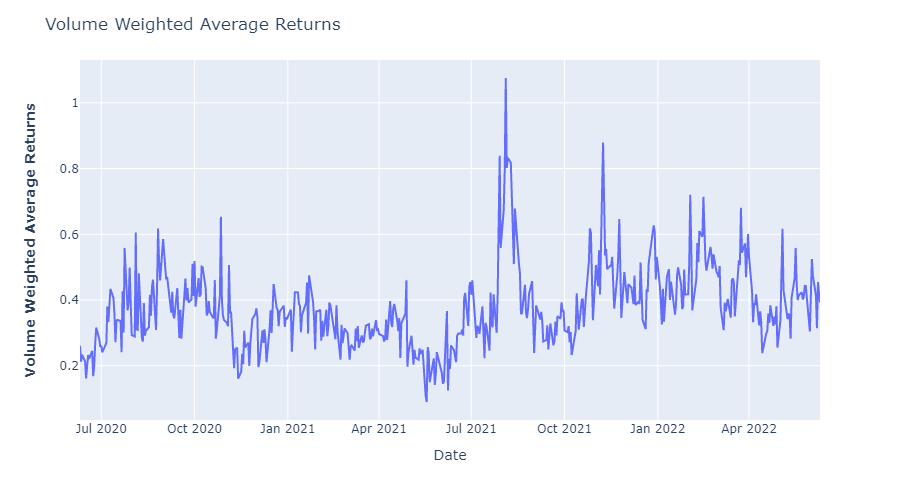

In [4]:
import plotly.express as px

fig = px.line(data.reset_index(), x='Date', y="Volume-weighted average daily returns", width=1000, height=500)




# Add figure title
fig.update_layout(
    title_text="Volume Weighted Average Returns",
)

# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text="<b>Volume Weighted Average Returns</b>")
fig.show()

# b. Plot the moving average daily return in a separate line chart. Try using different moving windows and a gaussian smoother to see what gives you the best line without losing too much granularity.

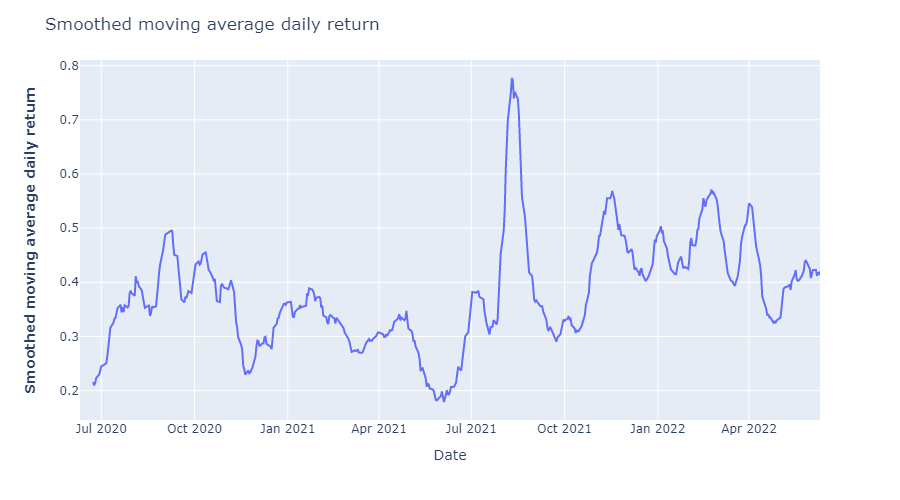

In [5]:
data['Smoothed moving average daily return'] = data['Volume-weighted average daily returns'].rolling(10).mean()


fig = px.line(data.reset_index(), x='Date', y="Smoothed moving average daily return", width=1000, height=500)




# Add figure title
fig.update_layout(
    title_text="Smoothed moving average daily return",
)

# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text="<b>Smoothed moving average daily return</b>")

fig.show()

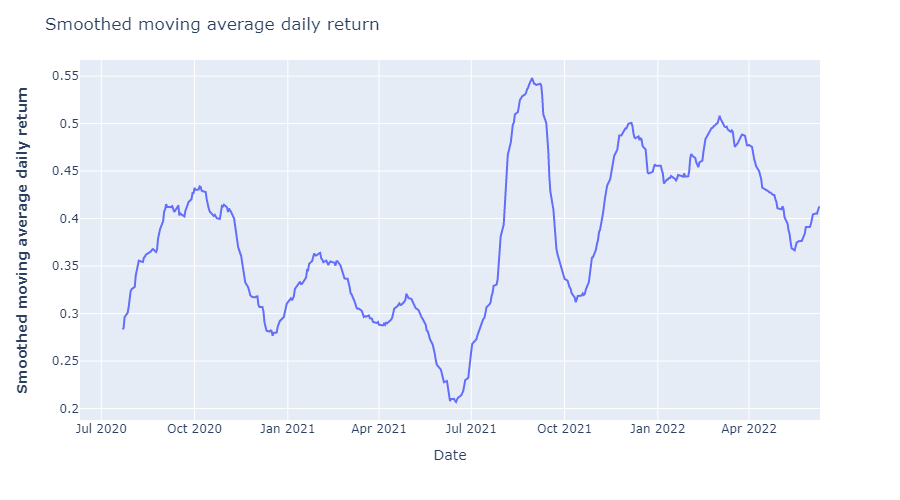

In [6]:
data['Smoothed moving average daily return'] = data['Volume-weighted average daily returns'].rolling(30).mean()


fig = px.line(data.reset_index(), x='Date', y="Smoothed moving average daily return", width=1000, height=500)




# Add figure title
fig.update_layout(
    title_text="Smoothed moving average daily return",
)

# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text="<b>Smoothed moving average daily return</b>")

fig.show()

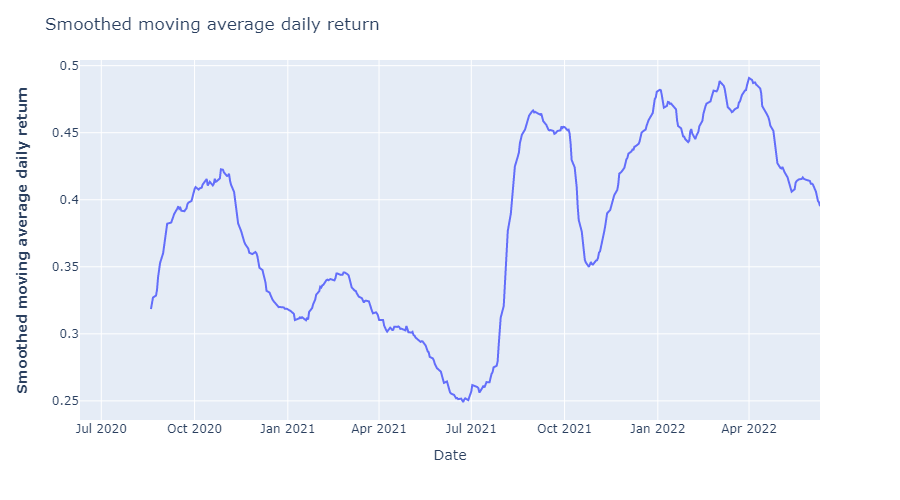

In [7]:
data['Smoothed moving average daily return'] = data['Volume-weighted average daily returns'].rolling(50).mean()


fig = px.line(data.reset_index(), x='Date', y="Smoothed moving average daily return", width=1000, height=500)




# Add figure title
fig.update_layout(
    title_text="Smoothed moving average daily return",
)

# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text="<b>Smoothed moving average daily return</b>")

fig.show()

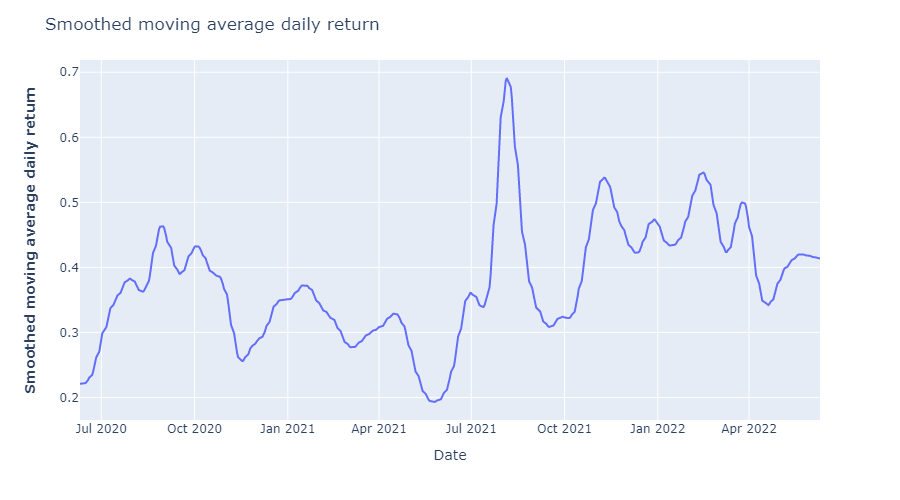

In [8]:
from scipy.ndimage import gaussian_filter

# More fair smoothing
data['Smoothed moving average daily return'] = gaussian_filter(data['Volume-weighted average daily returns'],5)


fig = px.line(data.reset_index(), x='Date', y="Smoothed moving average daily return", width=1000, height=500)




# Add figure title
fig.update_layout(
    title_text="Smoothed moving average daily return",
)

# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text="<b>Smoothed moving average daily return</b>")

fig.show()

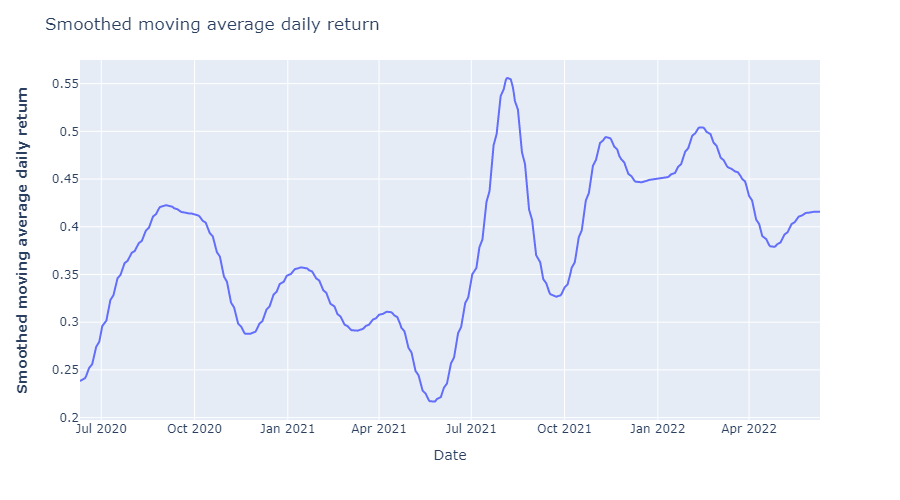

In [9]:
data['Smoothed moving average daily return'] = gaussian_filter(data['Volume-weighted average daily returns'],10)


fig = px.line(data.reset_index(), x='Date', y="Smoothed moving average daily return", width=1000, height=500)




# Add figure title
fig.update_layout(
    title_text="Smoothed moving average daily return",
)

# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text="<b>Smoothed moving average daily return</b>")

fig.show()

# c. Overlay the plots from a and b.

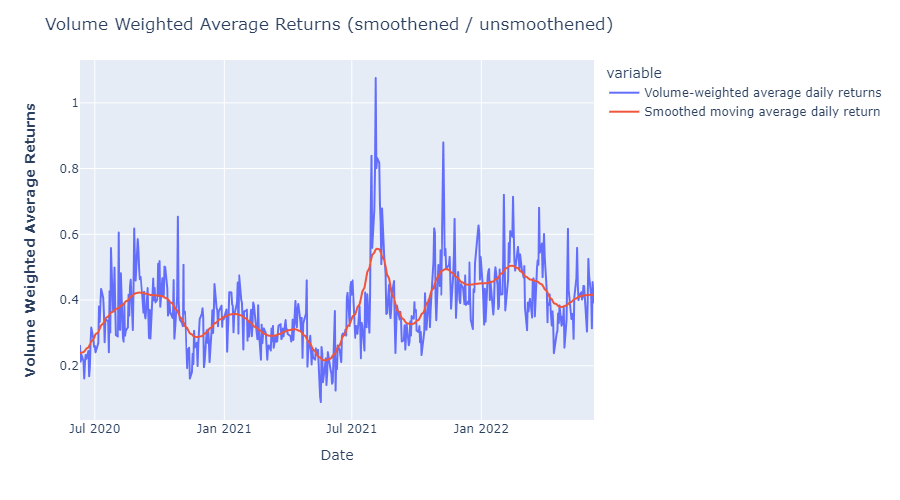

In [10]:
fig = px.line(data.reset_index(), x='Date', y=["Volume-weighted average daily returns","Smoothed moving average daily return"], width=1000, height=500)


# Add figure title
fig.update_layout(
    title_text="Volume Weighted Average Returns (smoothened / unsmoothened)",
)

# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text="<b>Volume Weighted Average Returns</b>")


fig.show()

# d. Plot the moving average volume on the same plot.

In [11]:
data['Average Volume'] = SP500.groupby(['Date']).apply(lambda x: (np.average(x['Volume'])))
data

,Volume-weighted average daily returns,Smoothed moving average daily return,Average Volume
Date,,,
2020-06-10,0.260742,0.238356,6.937053e+06
2020-06-11,0.212743,0.238865,8.769748e+06
2020-06-12,0.233559,0.239872,7.285449e+06
2020-06-15,0.213383,0.241378,6.761026e+06
2020-06-16,0.161214,0.243372,6.971778e+06
...,...,...,...
2022-06-06,0.413240,0.415694,3.922972e+06
2022-06-07,0.313961,0.415773,4.250754e+06
2022-06-08,0.454478,0.415822,3.760583e+06


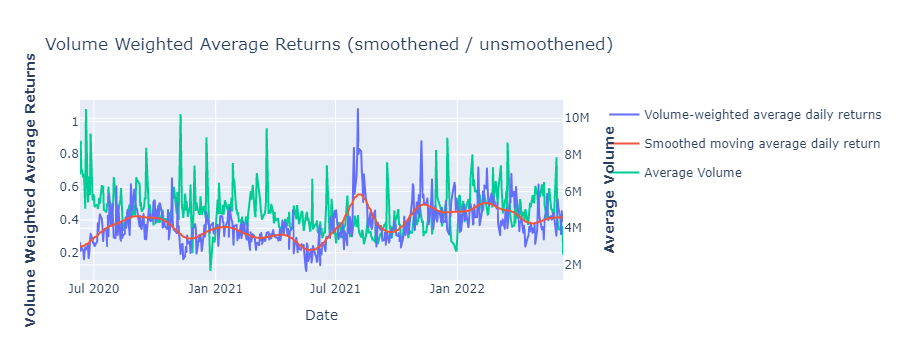

In [12]:
from plotly.subplots import make_subplots


fig = make_subplots(specs=[[{"secondary_y": True}]])


fig1 = px.line(data[['Volume-weighted average daily returns', 'Smoothed moving average daily return']])
fig2 = px.line(data[['Average Volume']])

fig2.update_traces(yaxis="y2")

fig.add_traces(fig1.data + fig2.data)


# Add figure title
fig.update_layout(
    title_text="Volume Weighted Average Returns (smoothened / unsmoothened)",
)

# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text="<b>Volume Weighted Average Returns</b>", secondary_y=False)
fig.update_yaxes(title_text="<b>Average Volume</b> ", secondary_y=True)

fig.for_each_trace(lambda t: t.update(line=dict(color=t.marker.color)))

fig.show()

# 9.4 

# a. Plot the distribution of daily volume using a histogram. Pick the ideal number of bins.

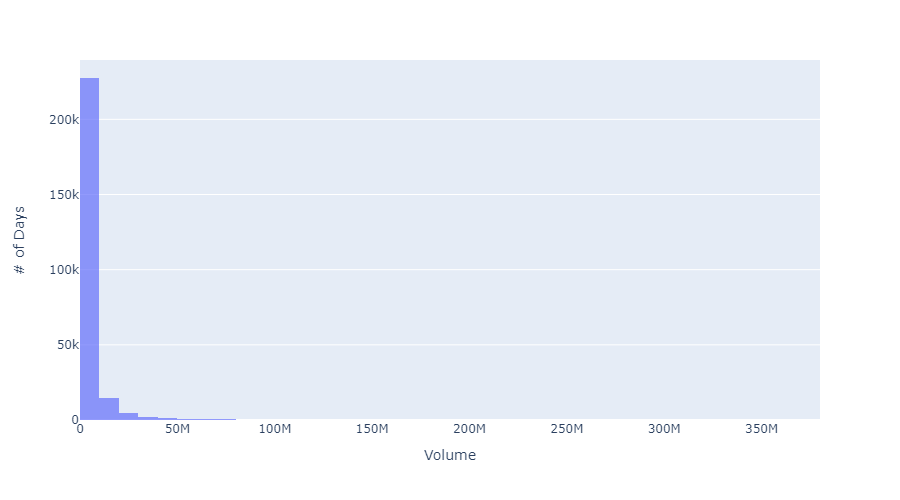

In [13]:
fig = px.histogram(SP500, x=SP500['Volume'],
                        nbins = 40,opacity=0.7, width=1000, height=500) 


# Axes
fig.update_xaxes(title_text='Volume')
fig.update_yaxes(title_text='# of Days')
fig.show()

# b. Plot the distribution of daily volume for each of the two years, using a histogram. You should have two overlaying histograms on the same plot

In [14]:
x_a = SP500[SP500['Date']<'2021-06-10']
x_a['Year'] = 'Year 1'

x_b = SP500[SP500['Date']>='2021-06-10']
x_b['Year'] ='Year 2'


<ipython-input-14-a75b47476e1c>:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-14-a75b47476e1c>:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



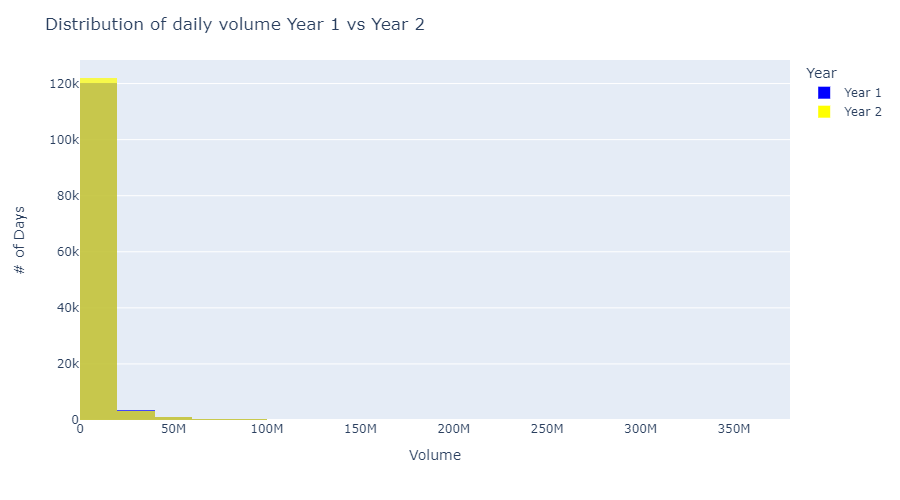

In [15]:
fig = px.histogram(x_a, x=x_a['Volume'],nbins = 30,opacity=0.7, width=1000, height=500,color_discrete_sequence=['blue'], color='Year')
fig2 = px.histogram(x_b, x=x_b['Volume'],nbins = 30,opacity=0.7, width=1000, height=500,color_discrete_sequence=['yellow'],color='Year')



fig.add_trace(fig2.data[0])


fig.update_layout(barmode='overlay',title_text="Distribution of daily volume Year 1 vs Year 2",)


# Axes

fig.update_xaxes(title_text='Volume')
fig.update_yaxes(title_text='# of Days')
fig.show()

# 9.5

In [16]:
scaffold_Portfolio=pd.read_csv('scaffold_Portfolio.csv')
scaffold_Portfolio.reset_index()
del scaffold_Portfolio['Unnamed: 0']

scaffold_Portfolio["Date"] = pd.to_datetime(scaffold_Portfolio["Date"])
scaffold_Portfolio = scaffold_Portfolio.set_index(['Date'])


scaffold_Portfolio

,Ticker,Position,Company Name,SEC filings,GICS Sector,GICS Sub-Industry,Headquarters Location,Date first added,CIK,Founded,...,Low,Open,Stock Splits,Volume,Daily return,1-week (5-day) moving average daily return,Rolling cumulative sum of volume,Daily P&L,Cumulative Daily P&L,Cumulative Daily Portfolio P&L
Date,,,,,,,,,,,,,,,,,,,,,
2020-06-11,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,1999,...,83.963763,87.528915,0.0,2491300.0,NaN,NaN,2.491300e+06,NaN,NaN,NaN
2020-06-12,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,1999,...,82.946557,85.751279,0.0,1520000.0,-0.343630,0.666799,4.386394e+09,-343.629883,-3.436299e+02,-3.436299e+02
2020-06-15,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,1999,...,82.670045,83.351475,0.0,1551400.0,-0.352033,0.661675,8.029150e+09,-352.032508,-6.956624e+02,-6.956624e+02
2020-06-16,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,1999,...,85.435260,87.775812,0.0,1049200.0,-0.344692,0.631249,1.140916e+10,-344.692313,-1.040355e+03,-1.040355e+03
2020-06-17,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,1999,...,86.373459,86.758613,0.0,900800.0,-0.355314,0.633189,1.489490e+10,-355.313842,-1.395669e+03,-1.395669e+03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-06-08,AJG,-24000.0,Gallagher,reports,Financials,Insurance Brokers,"Rolling Meadows, Illinois",2016-05-31,354190.0,1927,...,160.839996,162.570007,0.0,467200.0,-0.116774,0.578155,1.239167e+12,2802.566125,6.056764e+04,3.262179e+07
2022-06-08,AKAM,25000.0,Akamai,reports,Information Technology,Internet Services & Infrastructure,"Cambridge, Massachusetts",2007-07-12,1086222.0,1998,...,100.739998,101.550003,0.0,840600.0,-0.374860,0.658978,1.239168e+12,-9371.509071,-5.631417e+04,3.261242e+07
2022-06-08,AMZN,-12000.0,Amazon,reports,Consumer Discretionary,Internet & Direct Marketing Retail,"Seattle, Washington",2005-11-18,1018724.0,1994,...,120.750000,122.610001,0.0,64926600.0,-0.541783,0.150232,1.239351e+12,6501.398886,1.275273e+06,3.261892e+07


In [17]:
scaffold_Portfolio.dropna(subset=['Cumulative Daily P&L'], inplace=True)
scaffold_Portfolio

,Ticker,Position,Company Name,SEC filings,GICS Sector,GICS Sub-Industry,Headquarters Location,Date first added,CIK,Founded,...,Low,Open,Stock Splits,Volume,Daily return,1-week (5-day) moving average daily return,Rolling cumulative sum of volume,Daily P&L,Cumulative Daily P&L,Cumulative Daily Portfolio P&L
Date,,,,,,,,,,,,,,,,,,,,,
2020-06-12,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,1999,...,82.946557,85.751279,0.0,1520000.0,-0.343630,0.666799,4.386394e+09,-343.629883,-3.436299e+02,-3.436299e+02
2020-06-15,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,1999,...,82.670045,83.351475,0.0,1551400.0,-0.352033,0.661675,8.029150e+09,-352.032508,-6.956624e+02,-6.956624e+02
2020-06-16,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,1999,...,85.435260,87.775812,0.0,1049200.0,-0.344692,0.631249,1.140916e+10,-344.692313,-1.040355e+03,-1.040355e+03
2020-06-17,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,1999,...,86.373459,86.758613,0.0,900800.0,-0.355314,0.633189,1.489490e+10,-355.313842,-1.395669e+03,-1.395669e+03
2020-06-18,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,1999,...,86.175948,86.343835,0.0,1491500.0,-0.355788,0.654477,1.758796e+10,-355.787915,-1.751456e+03,-1.751456e+03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-06-08,AJG,-24000.0,Gallagher,reports,Financials,Insurance Brokers,"Rolling Meadows, Illinois",2016-05-31,354190.0,1927,...,160.839996,162.570007,0.0,467200.0,-0.116774,0.578155,1.239167e+12,2802.566125,6.056764e+04,3.262179e+07
2022-06-08,AKAM,25000.0,Akamai,reports,Information Technology,Internet Services & Infrastructure,"Cambridge, Massachusetts",2007-07-12,1086222.0,1998,...,100.739998,101.550003,0.0,840600.0,-0.374860,0.658978,1.239168e+12,-9371.509071,-5.631417e+04,3.261242e+07
2022-06-08,AMZN,-12000.0,Amazon,reports,Consumer Discretionary,Internet & Direct Marketing Retail,"Seattle, Washington",2005-11-18,1018724.0,1994,...,120.750000,122.610001,0.0,64926600.0,-0.541783,0.150232,1.239351e+12,6501.398886,1.275273e+06,3.261892e+07


# a. Plot cumulative PnL for each ticker from your portfolio, on the same plot. Hint: Use DataFrame pivoting functionality.

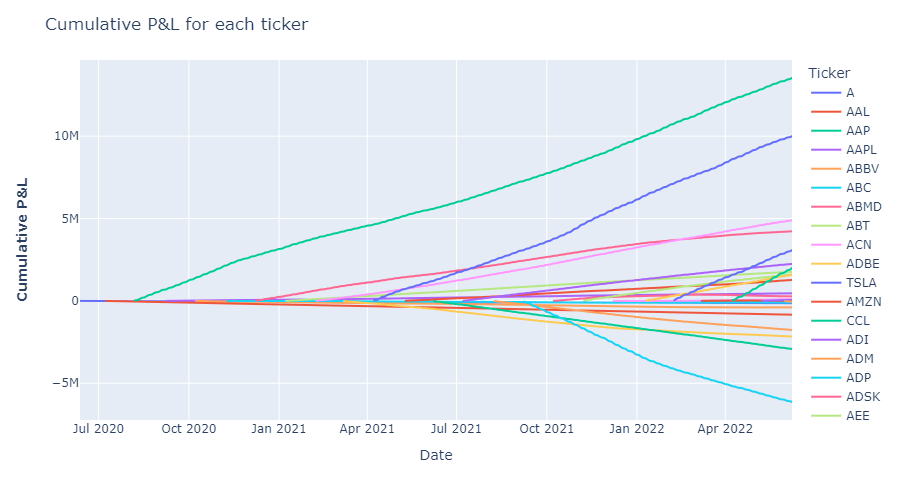

In [18]:
fig = px.line(scaffold_Portfolio.reset_index(), x='Date', y='Cumulative Daily P&L', color='Ticker', width=1000, height=500)


    
# Add figure title
fig.update_layout(
    title_text="Cumulative P&L for each ticker",
)
    
# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text="<b>Cumulative P&L</b>", secondary_y=False)


fig.show(width=1000, height=500)

In [19]:
# Show the plot again via using DataFrame pivoting functionality 
p = pd.pivot_table(data=scaffold_Portfolio,
                                   index=['Ticker', 'Date'],
                                   values=['Cumulative Daily P&L'])

p = p.reset_index()

p

,Ticker,Date,Cumulative Daily P&L
0,A,2020-06-12,-3.436299e+02
1,A,2020-06-15,-6.956624e+02
2,A,2020-06-16,-1.040355e+03
3,A,2020-06-17,-1.395669e+03
4,A,2020-06-18,-1.751456e+03
...,...,...,...
6317,TSLA,2022-06-02,9.888081e+06
6318,TSLA,2022-06-03,9.916883e+06
6319,TSLA,2022-06-06,9.945379e+06
6320,TSLA,2022-06-07,9.973577e+06


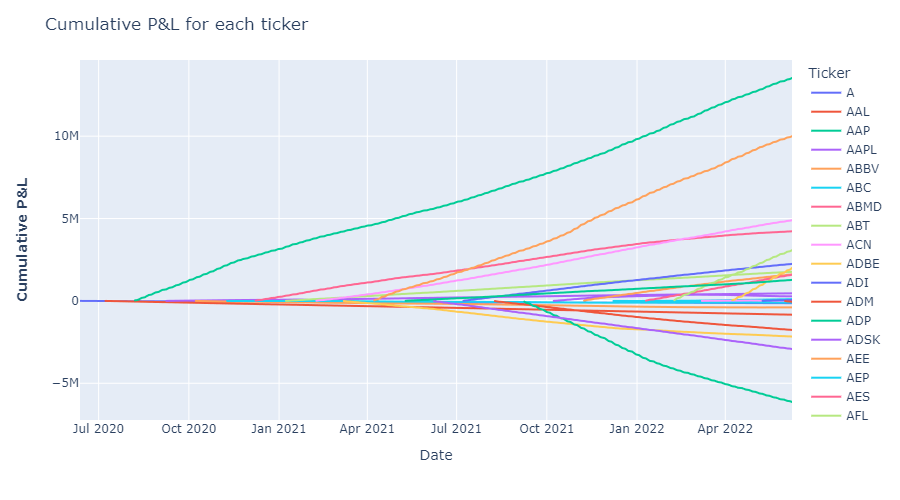

In [20]:
fig = px.line(p.reset_index(), x='Date', y='Cumulative Daily P&L', color='Ticker', width=1000, height=500)


    
# Add figure title
fig.update_layout(
    title_text="Cumulative P&L for each ticker",
)
    
# Set x-axis title
fig.update_xaxes(title_text="Date")

# Set y-axes titles
fig.update_yaxes(title_text="<b>Cumulative P&L</b>", secondary_y=False)


fig.show(width=1000, height=500)

# b. Create a scatter plot of PnL per ticker, year 1 vs year 2. Use different color points for each ticker, and use alpha as appropriate

In [21]:
scaffold_Portfolio.dropna(subset=['Daily P&L'], inplace=True)
scaffold_Portfolio = scaffold_Portfolio.reset_index()
scaffold_Portfolio

,Date,Ticker,Position,Company Name,SEC filings,GICS Sector,GICS Sub-Industry,Headquarters Location,Date first added,CIK,...,Low,Open,Stock Splits,Volume,Daily return,1-week (5-day) moving average daily return,Rolling cumulative sum of volume,Daily P&L,Cumulative Daily P&L,Cumulative Daily Portfolio P&L
0,2020-06-12,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,...,82.946557,85.751279,0.0,1520000.0,-0.343630,0.666799,4.386394e+09,-343.629883,-3.436299e+02,-3.436299e+02
1,2020-06-15,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,...,82.670045,83.351475,0.0,1551400.0,-0.352033,0.661675,8.029150e+09,-352.032508,-6.956624e+02,-6.956624e+02
2,2020-06-16,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,...,85.435260,87.775812,0.0,1049200.0,-0.344692,0.631249,1.140916e+10,-344.692313,-1.040355e+03,-1.040355e+03
3,2020-06-17,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,...,86.373459,86.758613,0.0,900800.0,-0.355314,0.633189,1.489490e+10,-355.313842,-1.395669e+03,-1.395669e+03
4,2020-06-18,A,1000.0,Agilent Technologies,reports,Health Care,Health Care Equipment,"Santa Clara, California",2000-06-05,1090872.0,...,86.175948,86.343835,0.0,1491500.0,-0.355788,0.654477,1.758796e+10,-355.787915,-1.751456e+03,-1.751456e+03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6317,2022-06-08,AJG,-24000.0,Gallagher,reports,Financials,Insurance Brokers,"Rolling Meadows, Illinois",2016-05-31,354190.0,...,160.839996,162.570007,0.0,467200.0,-0.116774,0.578155,1.239167e+12,2802.566125,6.056764e+04,3.262179e+07
6318,2022-06-08,AKAM,25000.0,Akamai,reports,Information Technology,Internet Services & Infrastructure,"Cambridge, Massachusetts",2007-07-12,1086222.0,...,100.739998,101.550003,0.0,840600.0,-0.374860,0.658978,1.239168e+12,-9371.509071,-5.631417e+04,3.261242e+07
6319,2022-06-08,AMZN,-12000.0,Amazon,reports,Consumer Discretionary,Internet & Direct Marketing Retail,"Seattle, Washington",2005-11-18,1018724.0,...,120.750000,122.610001,0.0,64926600.0,-0.541783,0.150232,1.239351e+12,6501.398886,1.275273e+06,3.261892e+07
6320,2022-06-08,CCL,13000.0,Carnival,reports,Consumer Discretionary,"Hotels, Resorts & Cruise Lines","Miami, Florida",1998-12-22,815097.0,...,12.920000,13.350000,0.0,43179100.0,-0.929900,-0.086099,1.239530e+12,-12088.696087,-2.922958e+06,3.260683e+07


In [22]:
data = scaffold_Portfolio[['Date', 'Ticker', 'Daily P&L']]

data

,Date,Ticker,Daily P&L
0,2020-06-12,A,-343.629883
1,2020-06-15,A,-352.032508
2,2020-06-16,A,-344.692313
3,2020-06-17,A,-355.313842
4,2020-06-18,A,-355.787915
...,...,...,...
6317,2022-06-08,AJG,2802.566125
6318,2022-06-08,AKAM,-9371.509071
6319,2022-06-08,AMZN,6501.398886
6320,2022-06-08,CCL,-12088.696087


In [23]:
AAPL_y1 = data[(data.Ticker == 'AAPL') & (data['Date'] <= '2021-07-25')]
AAPL_y1 = AAPL_y1.reset_index()
del AAPL_y1['index']
del AAPL_y1['Date']
AAPL_y1 = AAPL_y1.rename(columns={"Daily P&L": "Year 1 Daily P&L"})

AAPL_y1

,Ticker,Year 1 Daily P&L
0,AAPL,979.823188
1,AAPL,912.669369
2,AAPL,998.093821
3,AAPL,1057.243803
4,AAPL,1021.369632
...,...,...
216,AAPL,1199.994118
217,AAPL,1189.577977
218,AAPL,1192.917116
219,AAPL,1177.883603


In [24]:
TSLA_y1 = data[(data.Ticker == 'TSLA') & (data['Date'] <= '2021-11-04')]
TSLA_y1 = TSLA_y1.reset_index()
del TSLA_y1['index']
del TSLA_y1['Date']
TSLA_y1 = TSLA_y1.rename(columns={"Daily P&L": "Year 1 Daily P&L"})

TSLA_y1

,Ticker,Year 1 Daily P&L
0,TSLA,32322.295632
1,TSLA,31641.702722
2,TSLA,33102.102616
3,TSLA,36678.863287
4,TSLA,35074.989414
...,...,...
143,TSLA,46094.145554
144,TSLA,51909.547977
145,TSLA,49492.912530
146,TSLA,51615.776354


In [25]:
CCL_y1 = data[(data.Ticker == 'CCL') & (data['Date'] <= '2021-12-06')]
CCL_y1 = CCL_y1.reset_index()
del CCL_y1['index']
del CCL_y1['Date']
CCL_y1 = CCL_y1.rename(columns={"Daily P&L": "Year 1 Daily P&L"})

CCL_y1

,Ticker,Year 1 Daily P&L
0,CCL,-10879.615765
1,CCL,-10931.134082
2,CCL,-11005.141552
3,CCL,-10951.387084
4,CCL,-11059.513191
...,...,...
122,CCL,-11718.754294
123,CCL,-11801.731289
124,CCL,-11727.081302
125,CCL,-11771.012657


In [26]:
AAPL_y2 = data[(data.Ticker == 'AAPL') & (data['Date'] > '2021-07-25')]
AAPL_y2 = AAPL_y2.reset_index()
del AAPL_y2['index']
del AAPL_y2['Date']
AAPL_y2 = AAPL_y2.rename(columns={"Daily P&L": "Year 2 Daily P&L"})

AAPL_y2

,Ticker,Year 2 Daily P&L
0,AAPL,1186.620981
1,AAPL,1245.012766
2,AAPL,1238.609348
3,AAPL,1240.858024
4,AAPL,1219.358919
...,...,...
216,AAPL,834.789688
217,AAPL,951.082512
218,AAPL,935.304704
219,AAPL,816.313217


In [27]:
TSLA_y2 = data[(data.Ticker == 'TSLA') & (data['Date'] > '2021-11-04')]
TSLA_y2 = TSLA_y2.reset_index()
del TSLA_y2['index']
del TSLA_y2['Date']
TSLA_y2 = TSLA_y2.rename(columns={"Daily P&L": "Year 2 Daily P&L"})

TSLA_y2

,Ticker,Year 2 Daily P&L
0,TSLA,50814.169018
1,TSLA,47463.646501
2,TSLA,40579.485147
3,TSLA,43711.343616
4,TSLA,43142.465962
...,...,...
143,TSLA,32650.792969
144,TSLA,28801.737135
145,TSLA,28495.908584
146,TSLA,28198.745367


In [28]:
CCL_y2 = data[(data.Ticker == 'CCL') & (data['Date'] > '2021-12-06')]
CCL_y2 = CCL_y2.reset_index()
del CCL_y2['index']
del CCL_y2['Date']
CCL_y2 = CCL_y2.rename(columns={"Daily P&L": "Year 2 Daily P&L"})

CCL_y2

,Ticker,Year 2 Daily P&L
0,CCL,-11728.274848
1,CCL,-11653.955096
2,CCL,-11663.242148
3,CCL,-11681.927376
4,CCL,-11780.402949
...,...,...
122,CCL,-12023.663272
123,CCL,-12040.482903
124,CCL,-12042.482971
125,CCL,-12036.674607


In [29]:
AAPL_y1['Year 2 Daily P&L'] = AAPL_y2['Year 2 Daily P&L']
TSLA_y1['Year 2 Daily P&L'] = TSLA_y2['Year 2 Daily P&L']
CCL_y1['Year 2 Daily P&L'] = CCL_y2['Year 2 Daily P&L']


allData = pd.concat([AAPL_y1,TSLA_y1,CCL_y1])

allData

,Ticker,Year 1 Daily P&L,Year 2 Daily P&L
0,AAPL,979.823188,1186.620981
1,AAPL,912.669369,1245.012766
2,AAPL,998.093821,1238.609348
3,AAPL,1057.243803,1240.858024
4,AAPL,1021.369632,1219.358919
...,...,...,...
122,CCL,-11718.754294,-12023.663272
123,CCL,-11801.731289,-12040.482903
124,CCL,-11727.081302,-12042.482971
125,CCL,-11771.012657,-12036.674607


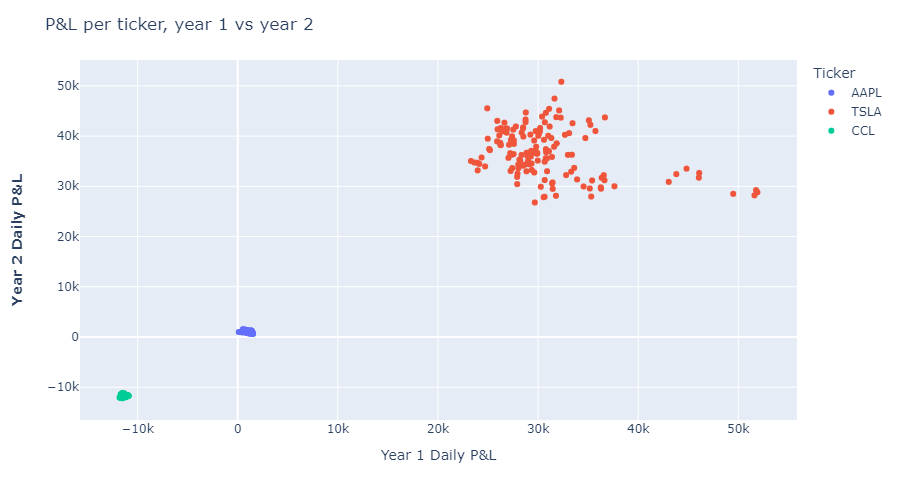

In [30]:
fig = px.scatter(allData, x='Year 1 Daily P&L', y='Year 2 Daily P&L', color='Ticker', width=1000, height=500)


# Add figure title
fig.update_layout(
    title_text="P&L per ticker, year 1 vs year 2",
)
    
# Set x-axis title
fig.update_xaxes(title_text="Year 1 Daily P&L")

# Set y-axes titles
fig.update_yaxes(title_text="<b>Year 2 Daily P&L</b>")


fig.show()